<a href="https://colab.research.google.com/github/arindm007/VisionLab_Assignment/blob/main/VisionLab_Assignment_pedestrian_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DINO  


## Dataset Preparation:
Split the dataset into two sets: a training set with 160 images and a validation set with 40 images.

In [ ]:
# performed on local machine to split into coco format

# custom_dataset/
#   ├── train_images/
#   ├── val_images/
#   └── annotations/
#   	├── instances_train_imagesd.json
#   	└── instances_val_images.json

## Setup of DINO reposatory
Clone the DINO repository from this link and set up the necessary environment and dependencies as outlined in the repository instructions.

follow : [installation](https://github.com/IDEA-Research/DINO/blob/main/README.md#installation)

In [ ]:
!git clone https://github.com/IDEA-Research/DINO.git

Cloning into 'DINO'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (191/191), done.
remote: Compressing objects: 100% (95/95), done.
remote: Total 442 (delta 136), reused 96 (delta 96), pack-reused 251 (from 1)
Receiving objects: 100% (442/442), 13.43 MiB | 24.09 MiB/s, done.
Resolving deltas: 100% (191/191), done.


In [ ]:
!mv -v /content/DINO/* /content/

renamed '/content/DINO/config' -> '/content/config'
renamed '/content/DINO/datasets' -> '/content/datasets'
renamed '/content/DINO/engine.py' -> '/content/engine.py'
renamed '/content/DINO/figs' -> '/content/figs'
renamed '/content/DINO/inference_and_visualization.ipynb' -> '/content/inference_and_visualization.ipynb'
renamed '/content/DINO/LICENSE' -> '/content/LICENSE'
renamed '/content/DINO/main.py' -> '/content/main.py'
renamed '/content/DINO/models' -> '/content/models'
renamed '/content/DINO/README.md' -> '/content/README.md'
renamed '/content/DINO/requirements.txt' -> '/content/requirements.txt'
renamed '/content/DINO/run_with_submitit.py' -> '/content/run_with_submitit.py'
renamed '/content/DINO/scripts' -> '/content/scripts'
renamed '/content/DINO/tools' -> '/content/tools'
renamed '/content/DINO/util' -> '/content/util'


In [ ]:
!rm -rf /content/DINO

In [ ]:
import torch
import torchvision

In [ ]:
!pip install -r requirements.txt

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-install-pg4v0iia/pycocotools_8599aad97a9743348f22f92d6838a614
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-install-pg4v0iia/pycocotools_8599aad97a9743348f22f92d6838a614
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/cocodataset/panopticapi.git to /tmp/pip-install-pg4v0iia/panopticapi_f6a1cdd898554926bc79b7b8c696ea01
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/panopticapi.git /tmp/pip-install-pg4v0iia/panopticapi_f6a1cdd898554926bc79b7b8c696ea01
  Resolved https://github.com/cocodataset/panopticapi.git to commit 7bb4655548f98f3fedc07bf37e9040a992b054b0
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━

In [ ]:
!python models/dino/ops/setup.py build install

running build
running build_py
creating build
creating build/lib.linux-x86_64-cpython-310
creating build/lib.linux-x86_64-cpython-310/datasets
copying datasets/random_crop.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/sltransform.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/panoptic_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/data_util.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/dataset.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/__init__.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/transforms.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_panoptic.py -> build/lib.linux-x86_64-cpython-310/datasets
creating build/lib.linux-x86_64-cpython-310/util
copying util/box_loss.py -> build

In [ ]:
!python models/dino/ops/test.py

* True check_forward_equal_with_pytorch_double: max_abs_err 8.67e-19 max_rel_err 2.35e-16
* True check_forward_equal_with_pytorch_float: max_abs_err 4.66e-10 max_rel_err 1.13e-07
* True check_gradient_numerical(D=30)
* True check_gradient_numerical(D=32)
* True check_gradient_numerical(D=64)
* True check_gradient_numerical(D=71)
* True check_gradient_numerical(D=1025)
Traceback (most recent call last):
  File "/content/models/dino/ops/test.py", line 86, in <module>
    check_gradient_numerical(channels, True, True, True)
  File "/content/models/dino/ops/test.py", line 76, in check_gradient_numerical
    gradok = gradcheck(func, (value.double(), shapes, level_start_index, sampling_locations.double(), attention_weights.double(), im2col_step))
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2053, in gradcheck
    return _gradcheck_helper(**args)
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2082, in _gradcheck_helper


#### NOTE: Last test failed due to OutOfMemoryError: CUDA out of memory. Tried to allocate 7.50 GiB. GPU 0

#### Installation Done ✅

## Download Pretrained model (R50, 4scale) --- Uploaded from drive

Download the pre-trained DINO-4scale model with the ResNet-50 (R50) backbone from the provided link in the repository.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp -r /content/drive/MyDrive/Vision_Internship/checkpoint0011_4scale.pth /content/

### Run on Custom Dataset for Validation

* Run evaluations on the validation set using the pre-trained weights, as COCO contains a "person" class relevant to this task.

* Need to import custom_dataset from the drive that was uploaded after creating with the help of train_val script on local machine

In [ ]:
# Custom Dataset Import
!cp -r /content/drive/MyDrive/Vision_Internship/custom_dataset.zip /content/

In [ ]:
!unzip /content/custom_dataset.zip > /dev/null

In [ ]:
# !rm -r custom_dataset


#### Validation

In [ ]:
!pip install yapf==0.40.1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.3/250.3 kB 10.3 MB/s eta 0:00:00
  Attempting uninstall: yapf
    Found existing installation: yapf 0.40.2
    Uninstalling yapf-0.40.2:
      Successfully uninstalled yapf-0.40.2


In [ ]:
import numpy as np
np.__version__


In [ ]:
!grep -rnw '/content/' -e 'np.float'

grep: /content/drive/MyDrive/Untitled form (1).gform: Operation not supported
grep: /content/drive/MyDrive/Untitled form.gform: Operation not supported
grep: /content/drive/MyDrive/Contact Information.gform: Operation not supported
grep: /content/drive/MyDrive/Untitled document (1).gdoc: Operation not supported
grep: /content/drive/MyDrive/Untitled document.gdoc: Operation not supported
grep: /content/drive/MyDrive/1_unit_15x15_2_goldenFmt.gdoc: Operation not supported
/content/drive/MyDrive/Colab Notebooks/VisionLab_Assignment_pedestrian_detection.ipynb:1:{"metadata":{"kernelspec":{"display_name":"Python 3","name":"python3"},"language_info":{"pygments_lexer":"ipython3","nbconvert_exporter":"python","version":"3.6.4","file_extension":".py","codemirror_mode":{"name":"ipython","version":3},"name":"python","mimetype":"text/x-python"},"colab":{"provenance":[],"gpuType":"T4"},"accelerator":"GPU"},"nbformat_minor":0,"nbformat":4,"cells":[{"cell_type":"markdown","source":["# DINO  \n"],"metad

In [ ]:
!pip install "numpy<1.24"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 97.4 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albucore 0.0.16 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.
albumentations 1.4.15 requires numpy>=1.24.4, but you have numpy 1.23.5 which is incompatible.
bigframes 1.17.0 requires numpy>=1.24.0, but you have numpy 1.23.5 which is incompatible.
chex 0.1.86 requires numpy>=1.24.1, but you have numpy 1.23.5 which is incompatible.
pandas-stubs 2.1.4.231227 requires numpy>=1.26.0; python_version < "3.13", but you have numpy 1.23.5 which is incompatible.
xarray 2024.9.0 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.


In [ ]:
# change path to custom dataset
!bash /content/scripts/DINO_eval.sh /content/custom_dataset /content/checkpoint0011_4scale.pth

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/24 04:22:49.771]: git:
  sha: N/A, status: clean, branch: N/A

[09/24 04:22:49.771]: Command: main.py --output_dir logs/DINO/R50-MS4-%j -c config/DINO/DINO_4scale.py --coco_path /content/custom_dataset --eval --resume /content/checkpoint0011_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/24 04:22:49.772]: Full config saved to logs/DINO/R50-MS4-%j/config_args_all.json
[09/24 04:22:49.772]: world size: 1
[09/24 04:22:49.772]: rank: 0
[09/24 04:22:49.772]: local_rank: 0
[09/24 04:22:49.773]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/custom_dataset', coco_panoptic_

## Visualizations of evalutaions (and Observations)  


In [ ]:
import os, sys
import torch, json
import numpy as np

from main import build_model_main
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

In [ ]:
model_config_path = "/content/config/DINO/DINO_4scale.py" # change the path of the model config file
model_checkpoint_path = "/content/checkpoint0011_4scale.pth"

In [ ]:
args = SLConfig.fromfile(model_config_path)
args.device = 'cuda'
model, criterion, postprocessors = build_model_main(args)
checkpoint = torch.load(model_checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint['model'])
_ = model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
<ipython-input-6-75b8576164e8>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details

In [ ]:
# load coco names
with open('util/coco_id2name.json') as f:
    id2name = json.load(f)
    id2name = {int(k):v for k,v in id2name.items()}

In [ ]:
# 1. Visualize images from a dataloader
# 1.1 Load Datasets
args.dataset_file = 'coco'
args.coco_path = "/content/custom_dataset" # the path of coco
args.fix_size = False

dataset_val = build_dataset(image_set='val', args=args)

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [ ]:
dataset_val

Dataset CocoDetection
    Number of datapoints: 40
    Root location: /content/custom_dataset/val_images

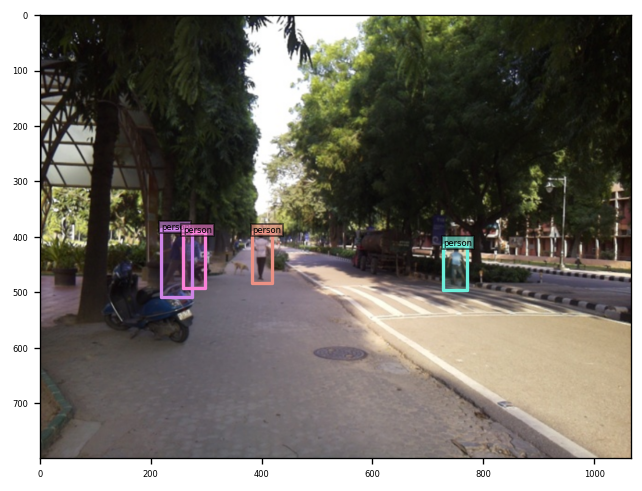

savename: /content/figs/pre-trained_inference/18-2024-09-24-05:01:52.877538.png


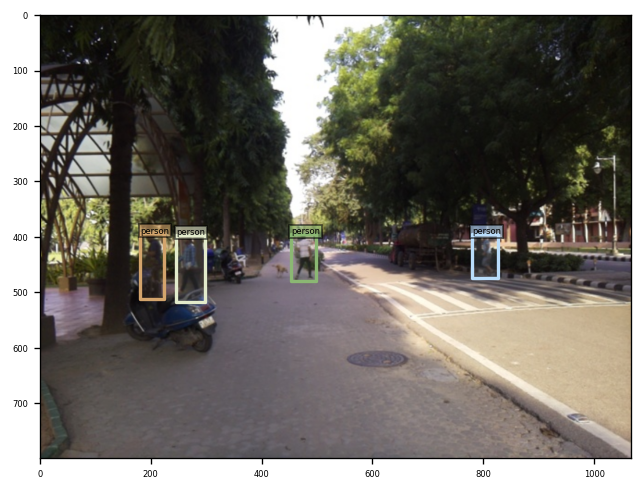

savename: /content/figs/pre-trained_inference/19-2024-09-24-05:01:53.459917.png


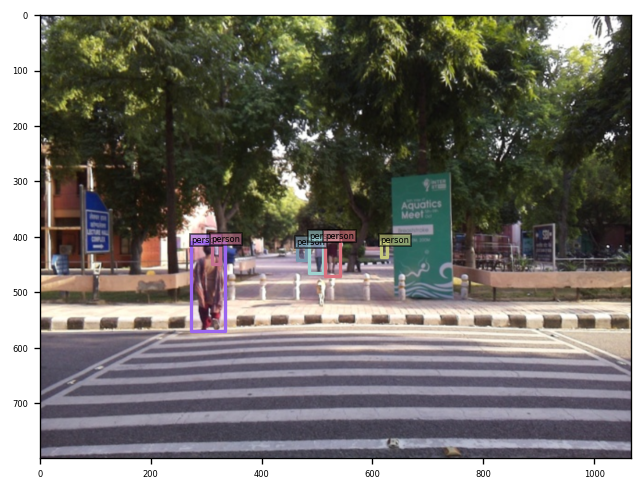

savename: /content/figs/pre-trained_inference/23-2024-09-24-05:01:54.072167.png


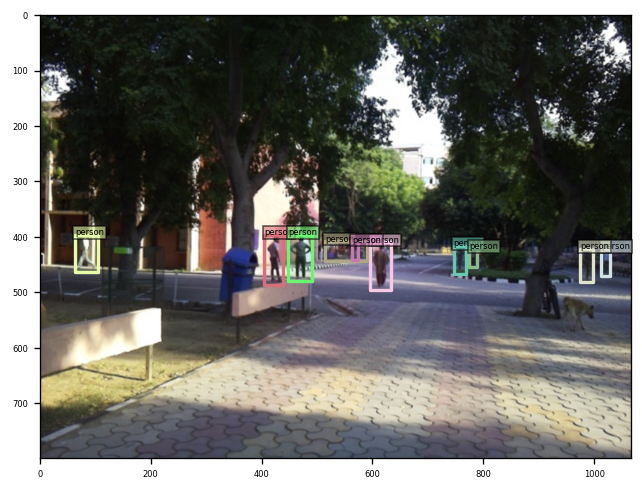

savename: /content/figs/pre-trained_inference/29-2024-09-24-05:01:54.714586.png


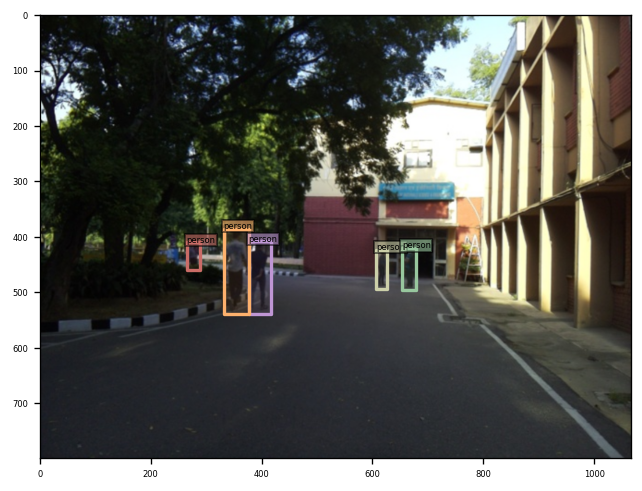

savename: /content/figs/pre-trained_inference/31-2024-09-24-05:01:55.317940.png


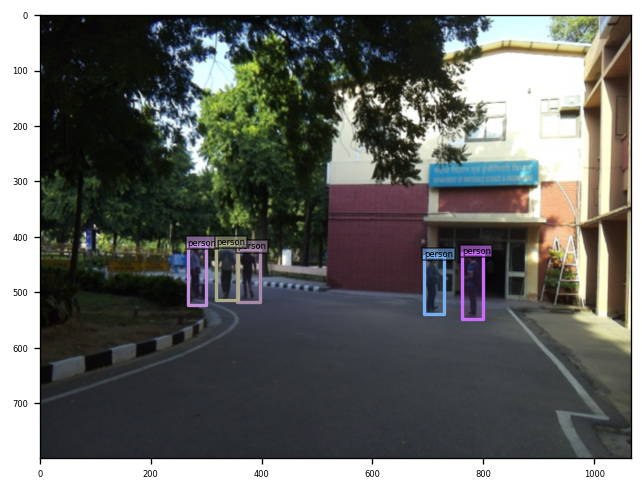

savename: /content/figs/pre-trained_inference/32-2024-09-24-05:01:56.018766.png


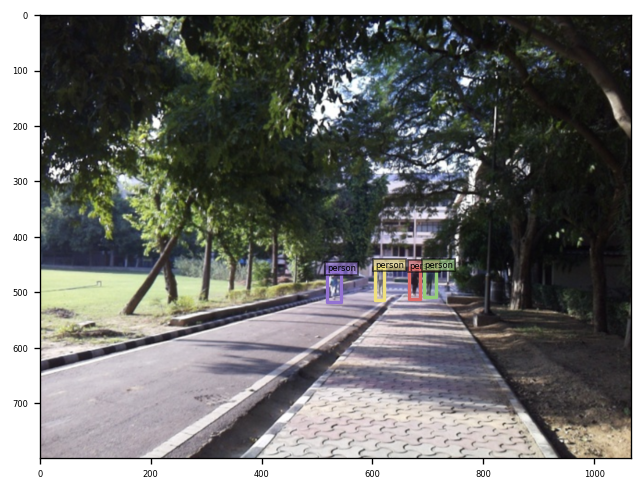

savename: /content/figs/pre-trained_inference/37-2024-09-24-05:01:56.866154.png


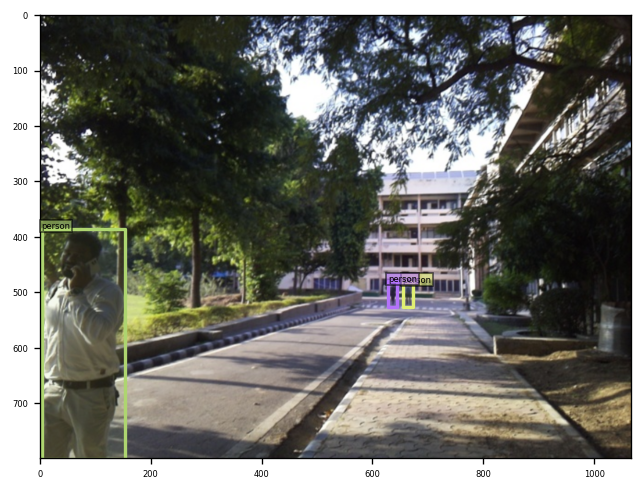

savename: /content/figs/pre-trained_inference/39-2024-09-24-05:01:58.046899.png


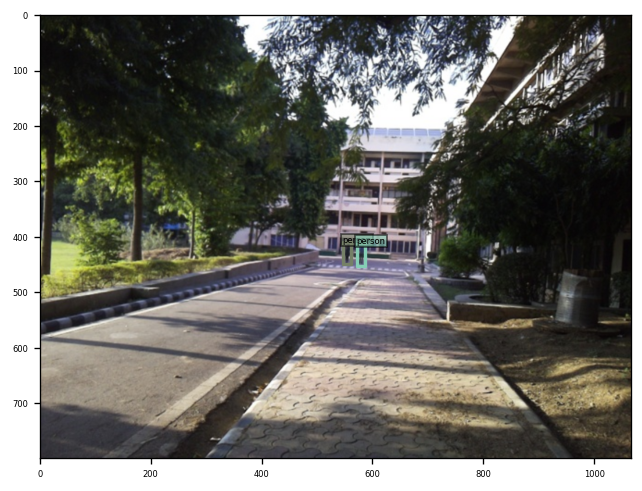

savename: /content/figs/pre-trained_inference/40-2024-09-24-05:01:59.269935.png


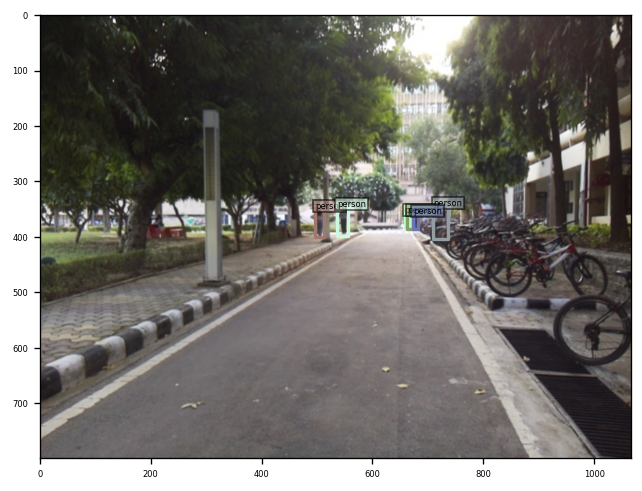

savename: /content/figs/pre-trained_inference/47-2024-09-24-05:02:00.543696.png


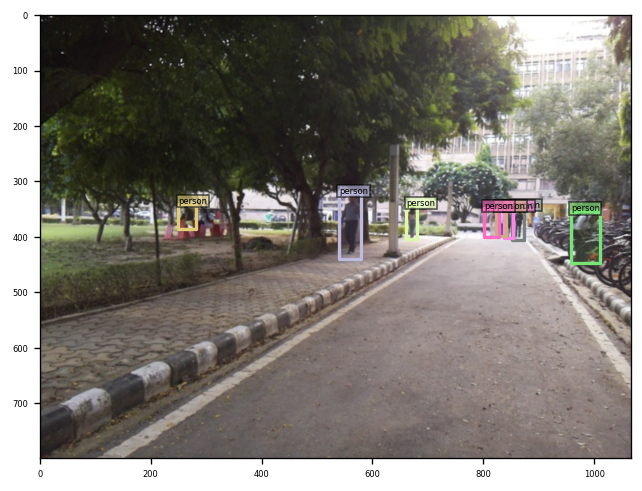

savename: /content/figs/pre-trained_inference/48-2024-09-24-05:02:01.722542.png


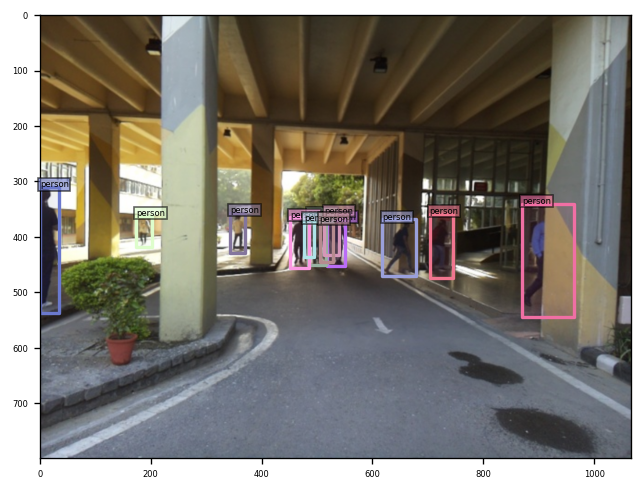

savename: /content/figs/pre-trained_inference/58-2024-09-24-05:02:03.081911.png


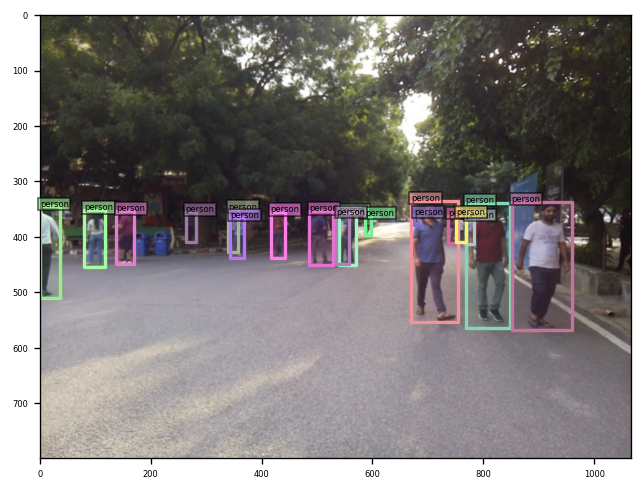

savename: /content/figs/pre-trained_inference/63-2024-09-24-05:02:03.734720.png


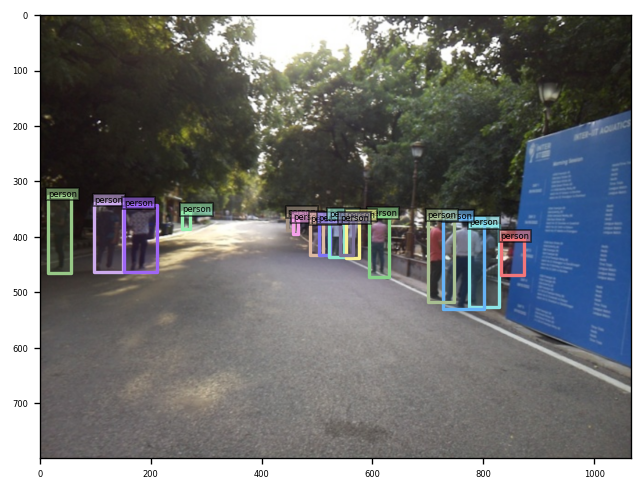

savename: /content/figs/pre-trained_inference/65-2024-09-24-05:02:04.440904.png


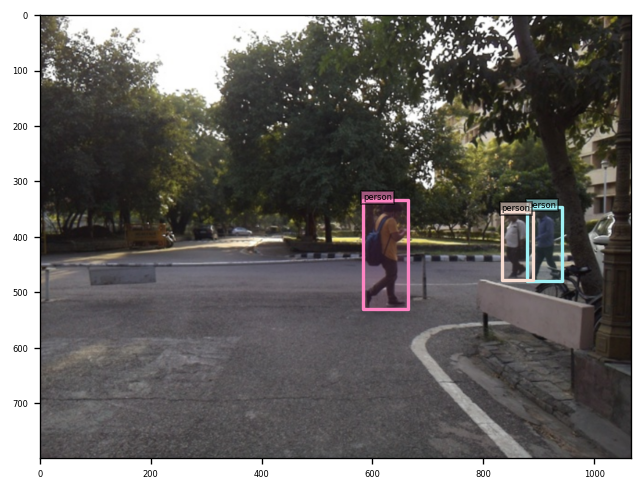

savename: /content/figs/pre-trained_inference/72-2024-09-24-05:02:05.115855.png


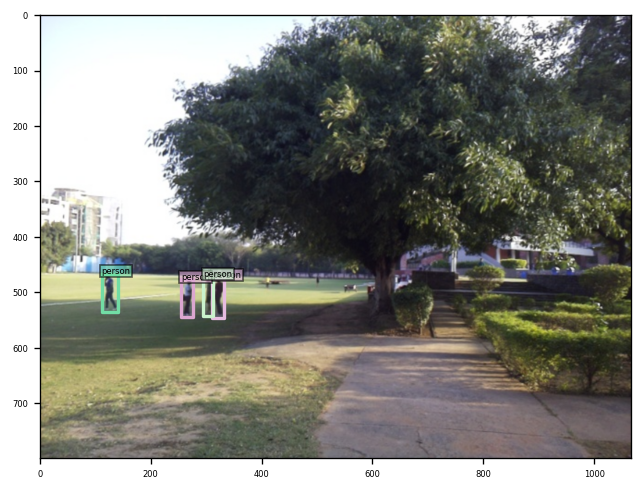

savename: /content/figs/pre-trained_inference/79-2024-09-24-05:02:05.762385.png


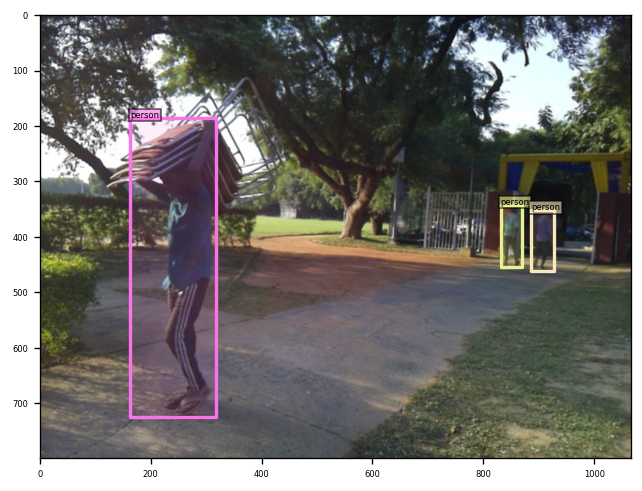

savename: /content/figs/pre-trained_inference/85-2024-09-24-05:02:06.461950.png


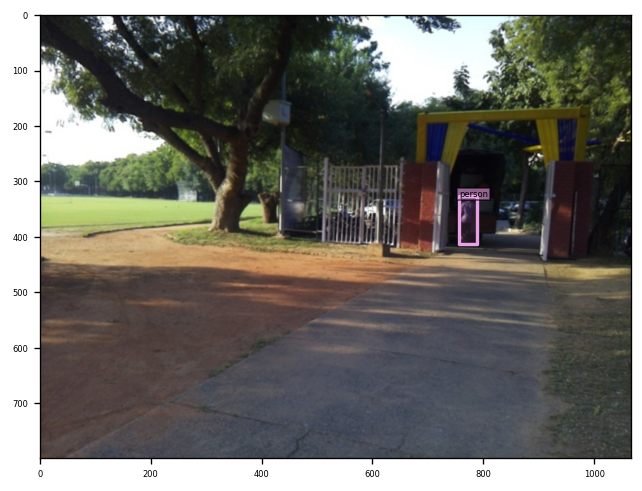

savename: /content/figs/pre-trained_inference/88-2024-09-24-05:02:07.124024.png


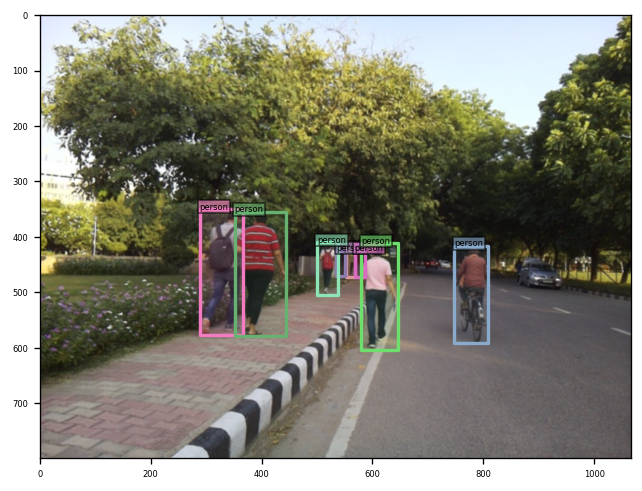

savename: /content/figs/pre-trained_inference/96-2024-09-24-05:02:07.775112.png


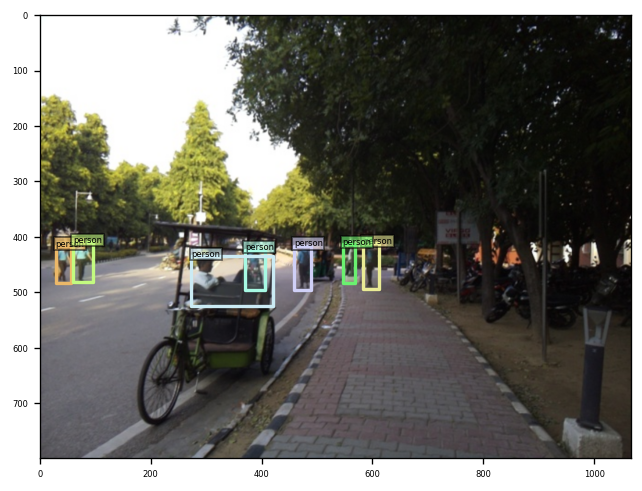

savename: /content/figs/pre-trained_inference/103-2024-09-24-05:02:08.683260.png


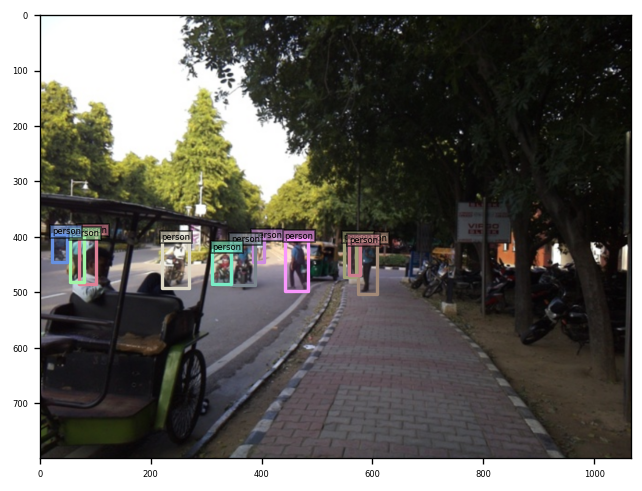

savename: /content/figs/pre-trained_inference/106-2024-09-24-05:02:09.375499.png


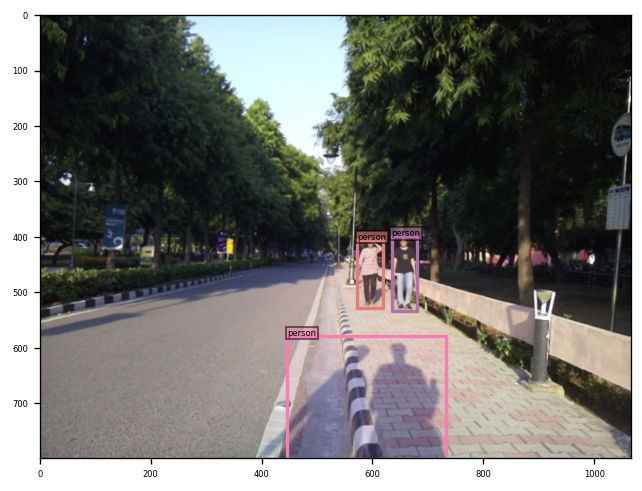

savename: /content/figs/pre-trained_inference/119-2024-09-24-05:02:10.043257.png


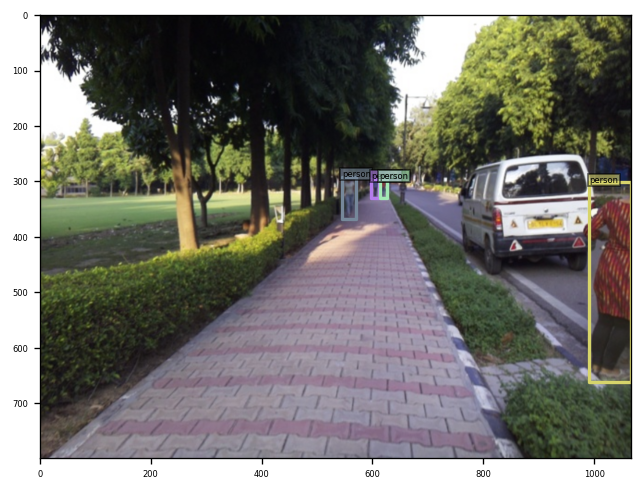

savename: /content/figs/pre-trained_inference/131-2024-09-24-05:02:10.735883.png


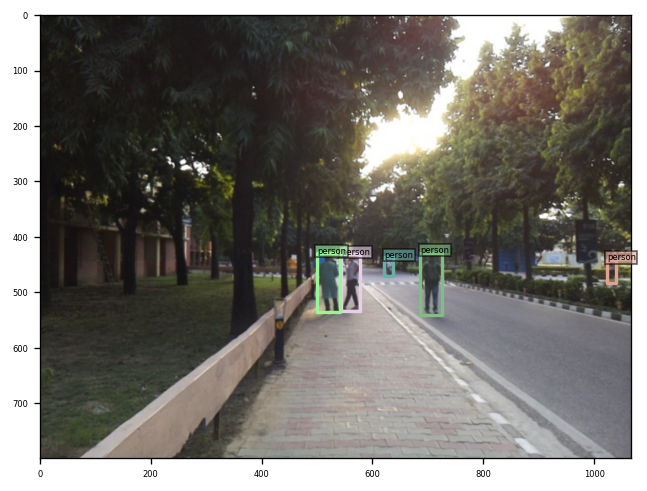

savename: /content/figs/pre-trained_inference/134-2024-09-24-05:02:11.449381.png


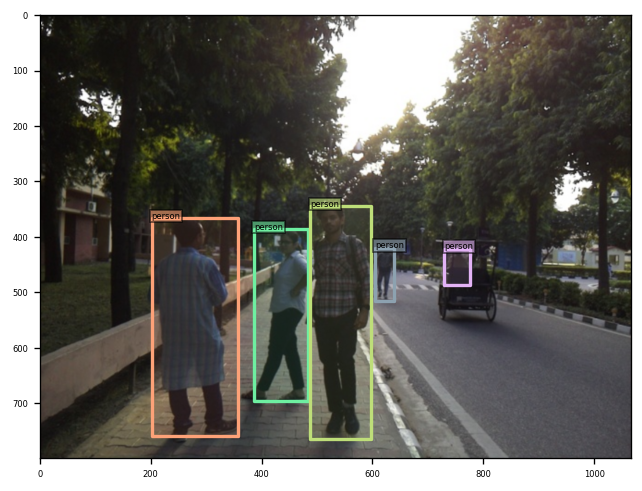

savename: /content/figs/pre-trained_inference/135-2024-09-24-05:02:12.176132.png


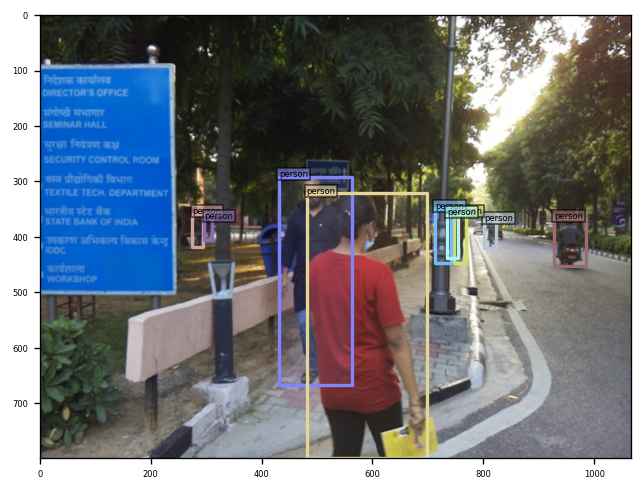

savename: /content/figs/pre-trained_inference/142-2024-09-24-05:02:13.063654.png


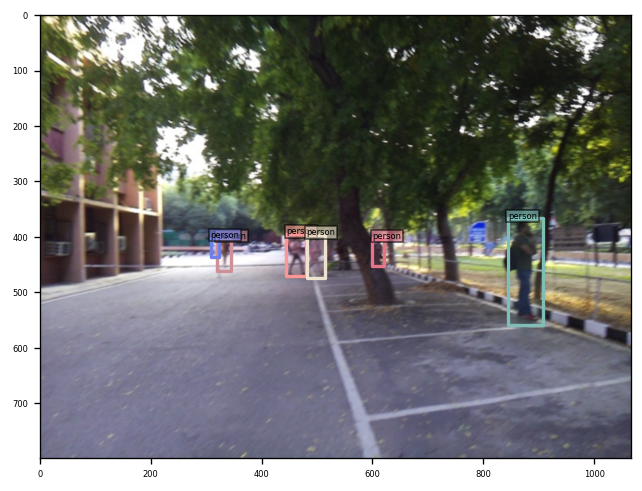

savename: /content/figs/pre-trained_inference/149-2024-09-24-05:02:14.277006.png


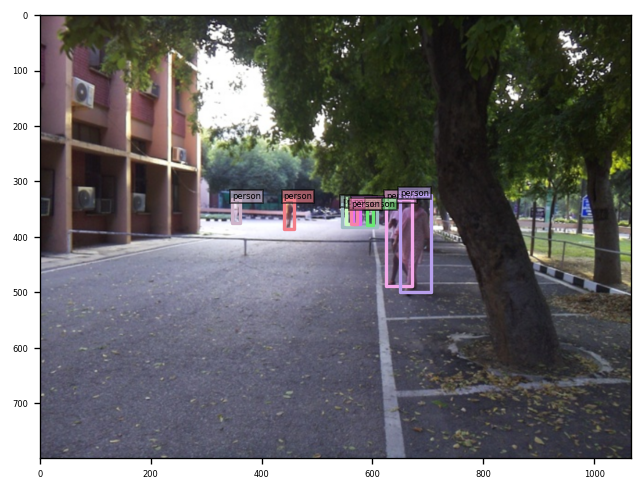

savename: /content/figs/pre-trained_inference/151-2024-09-24-05:02:15.187574.png


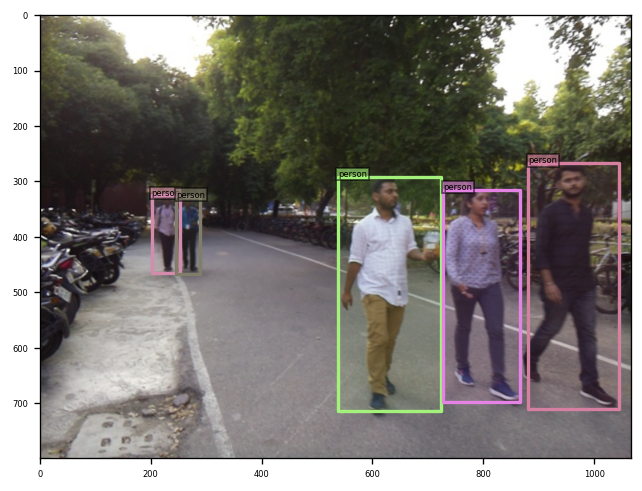

savename: /content/figs/pre-trained_inference/153-2024-09-24-05:02:16.120693.png


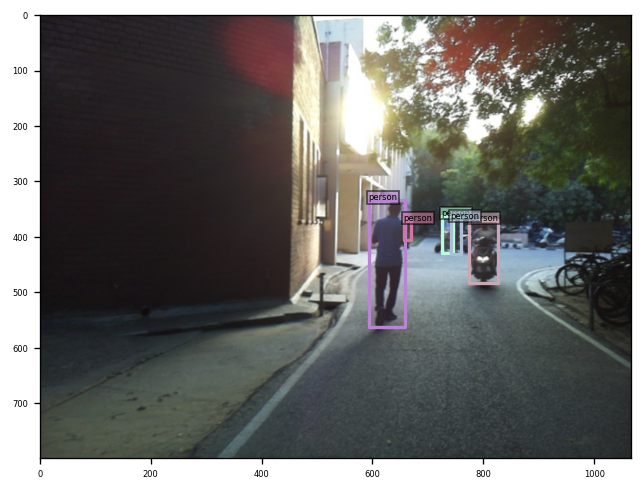

savename: /content/figs/pre-trained_inference/157-2024-09-24-05:02:16.961330.png


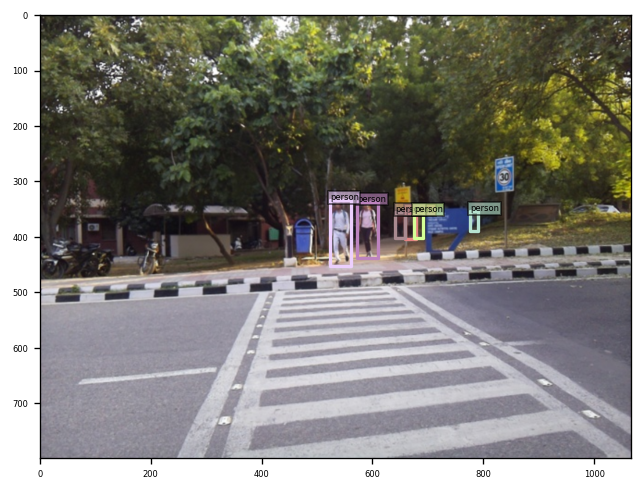

savename: /content/figs/pre-trained_inference/161-2024-09-24-05:02:17.806042.png


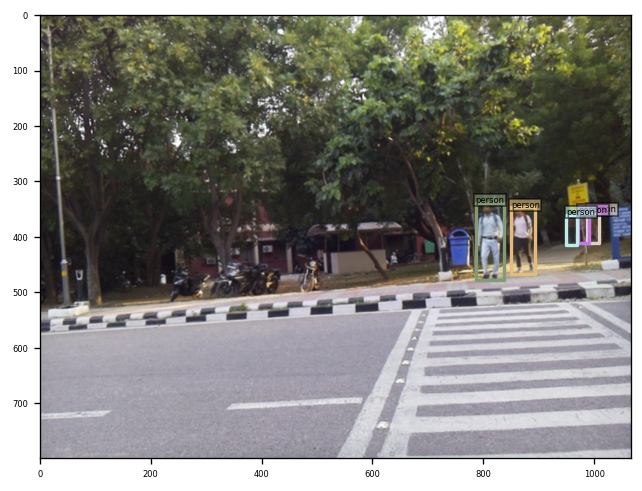

savename: /content/figs/pre-trained_inference/164-2024-09-24-05:02:18.716413.png


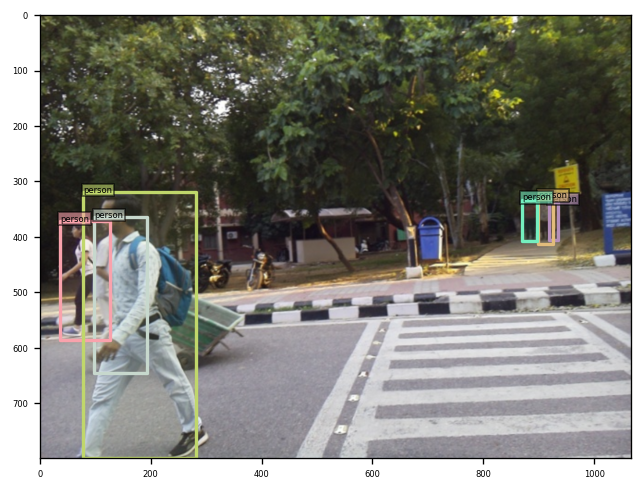

savename: /content/figs/pre-trained_inference/169-2024-09-24-05:02:19.600188.png


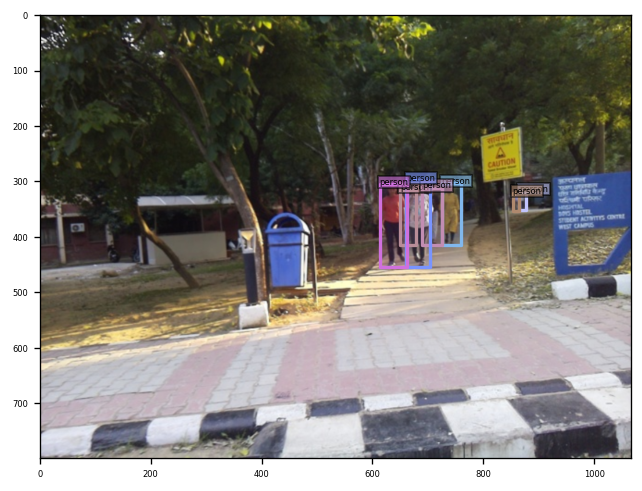

savename: /content/figs/pre-trained_inference/174-2024-09-24-05:02:20.502027.png


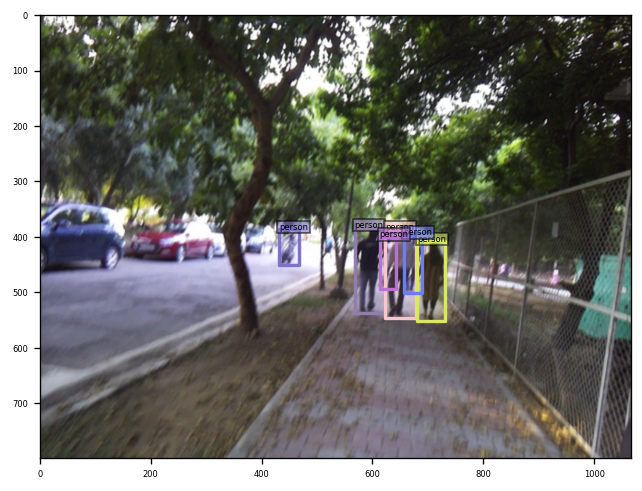

savename: /content/figs/pre-trained_inference/186-2024-09-24-05:02:21.339837.png


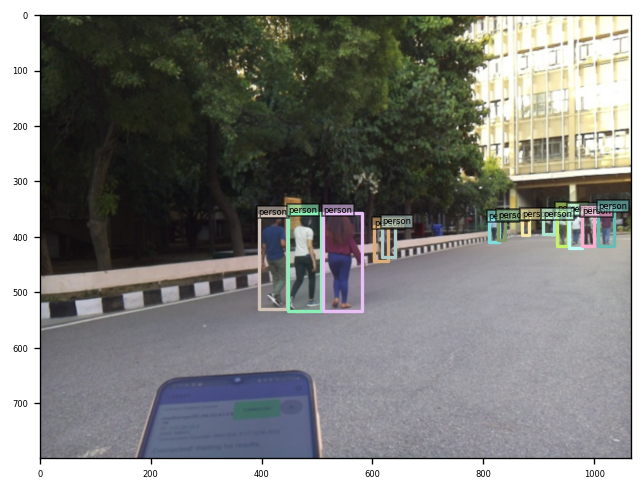

savename: /content/figs/pre-trained_inference/191-2024-09-24-05:02:22.088919.png


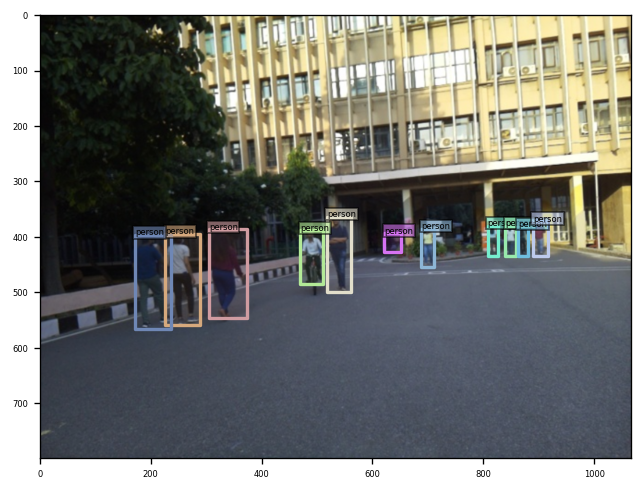

savename: /content/figs/pre-trained_inference/195-2024-09-24-05:02:22.873334.png


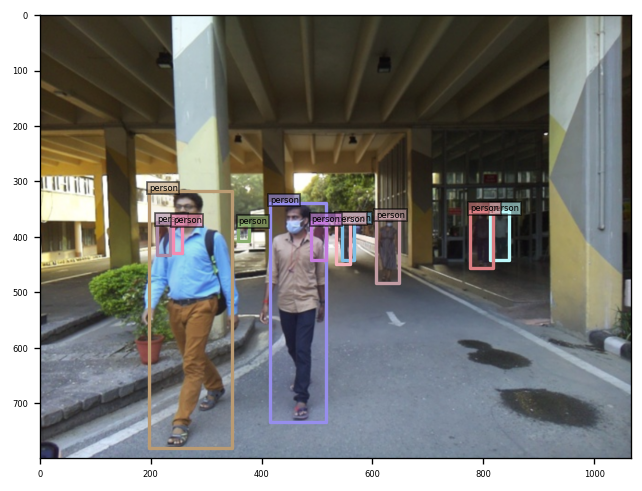

savename: /content/figs/pre-trained_inference/196-2024-09-24-05:02:23.670133.png


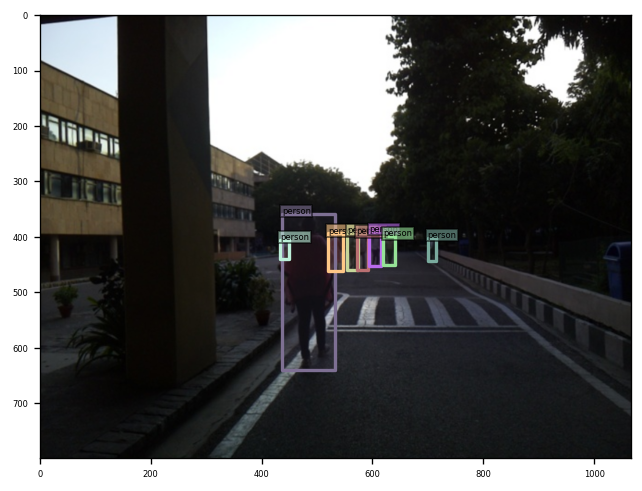

savename: /content/figs/pre-trained_inference/197-2024-09-24-05:02:24.424820.png


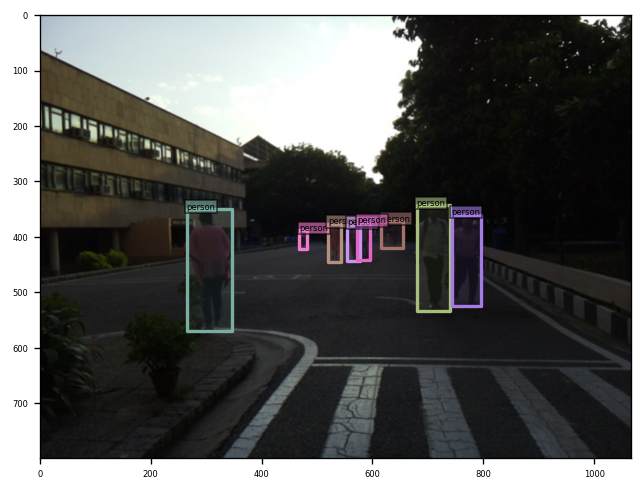

savename: /content/figs/pre-trained_inference/199-2024-09-24-05:02:25.180819.png
Error idx: 40


In [ ]:
# build gt_dict for vis
for batch in dataset_val:
  image, targets = batch
  box_label = [id2name[int(item)] for item in targets['labels']]
  gt_dict = {
      'boxes': targets['boxes'],
      'image_id': targets['image_id'],
      'size': targets['size'],
      'box_label': box_label,
  }
  vslzr = COCOVisualizer()
  vslzr.visualize(image, gt_dict, savedir="/content/figs/pre-trained_inference")

## T8 Fine-tuning on the training set (pre-trained: R50-12epochs -> fine-tuned: 12 epochs)


> logs saved at: logs/DINO/fine_tune_R50-MS4

In [ ]:
!bash scripts/DINO_train.sh /content/custom_dataset

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/24 05:07:03.815]: git:
  sha: N/A, status: clean, branch: N/A

[09/24 05:07:03.815]: Command: main.py --output_dir logs/DINO/R50-MS4 -c config/DINO/DINO_4scale.py --coco_path /content/custom_dataset --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/24 05:07:03.816]: Full config saved to logs/DINO/R50-MS4/config_args_all.json
[09/24 05:07:03.816]: world size: 1
[09/24 05:07:03.816]: rank: 0
[09/24 05:07:03.816]: local_rank: 0
[09/24 05:07:03.816]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/custom_dataset', coco_panoptic_path=None, remove_difficult=False, fix_size=False, output

---     

---    

In [ ]:
!zip -r /content/DINO_aryan.zip /content/*